# Lunar and Martian Crater Detection and Landing Site Analysis

**Objective:**
Crater detection and bounding box localization
Terrain steepness and type classification
Landing site suitability assessment

### Research findings

- The slope of the given landing site needs to be <5° to meet HLS lander terrain requirements.

  *source:* ARTEMIS III EVA MISSION CAPABILITY FOR DE GERLACHE-SHACKLETION RIDGE  Z.C. Scoville1, 1Arizona State University, NASA JSC, Houston, TX
- For landing safety, crater-free and flat regions are optimal for spacecarft landing.




## I. Environment Setup and Dependencies



In [1]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
import torchvision
from torchvision import transforms, models
from torchvision.models.detection import fasterrcnn_resnet50_fpn
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor

import cv2
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from PIL import Image
import os
import json
import glob
from pathlib import Path
from tqdm import tqdm
import pandas as pd
import warnings
import random
warnings.filterwarnings('ignore')

torch.manual_seed(42)
np.random.seed(42)


device_used = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"Using device_used: {device_used}")

if torch.cuda.is_available():

    print(f"GPU: {torch.cuda.get_device_name(0)}")
    print(f"CUDA Version: {torch.version.cuda}")
else:

    print("Running on CPU")

Using device_used: cuda
GPU: Tesla T4
CUDA Version: 12.6


## II. Data Paths

The image paths contain images from the lunar surface and the martian surface

In [2]:

TRAIN_image_path = "/content/Mars_Moon_Crater/train/images"
TRAIN_LABEL_PATH = "/content/Mars_Moon_Crater/train/labels"

VALID_image_path = "/content/Mars_Moon_Crater/valid/images"
VALID_LABEL_PATH = "/content/Mars_Moon_Crater/valid/labels"

TEST_image_path = "/content/Mars_Moon_Crater/test/images"
TEST_LABEL_PATH = "/content/Mars_Moon_Crater/test/labels"

OUTPUT_image_path = "/content/Mars_Moon_Crater"


paths_to_check = [
    ("Train Images", TRAIN_image_path),
    ("Train Labels", TRAIN_LABEL_PATH),
    ("Valid Images", VALID_image_path),
    ("Valid Labels", VALID_LABEL_PATH),
    ("Test Images", TEST_image_path),
    ("Test Labels", TEST_LABEL_PATH),
    ("Saved Images", OUTPUT_image_path)
]

for name, path in paths_to_check:
    if os.path.exists(path):

        files = [f for f in os.listdir(path) if os.path.isfile(os.path.join(path, f))]
        number_of_files = len(files)
        print(f"{name:20s}: {number_of_files:4d} files - {path}")
    else:
        print(f"{name:20s}: NOT FOUND - {path}")


Train Images        :   92 files - /content/Mars_Moon_Crater/train/images
Train Labels        :   98 files - /content/Mars_Moon_Crater/train/labels
Valid Images        :   26 files - /content/Mars_Moon_Crater/valid/images
Valid Labels        :   26 files - /content/Mars_Moon_Crater/valid/labels
Test Images         :   19 files - /content/Mars_Moon_Crater/test/images
Test Labels         :   19 files - /content/Mars_Moon_Crater/test/labels
Saved Images        :    1 files - /content/Mars_Moon_Crater


In [3]:
class CraterDataset(Dataset):


    def __init__(self, image_direction, label_direction, transform=None):
        self.image_direction = image_direction
        self.label_direction = label_direction
        self.transform = transform


        self.image_files = []
        for ext in ['*.jpg', '*.jpeg', '*.png', '*.JPG', '*.JPEG', '*.PNG']:
            self.image_files.extend(glob.glob(os.path.join(image_direction, ext)))

        self.image_files = sorted(self.image_files)

        if len(self.image_files) == 0:
            print(f"WARNING: No images found in {image_direction}")

    def __len__(self):
        return len(self.image_files)

    def __getitem__(self, idx):

        image_path = self.image_files[idx]
        img = cv2.imread(image_path)

        if img is None:
            print(f"Error loading image: {image_path}")

            img = np.zeros((256, 256, 3), dtype=np.uint8)

        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        image_width, image_w = img.shape[:2]

        image_basename = os.path.splitext(os.path.basename(image_path))[0]
        label_path = os.path.join(self.label_direction, image_basename + '.txt')

        boxes = []
        labels = []

        if os.path.exists(label_path):
            with open(label_path, 'r') as f:
                for line in f:
                    line = line.strip()
                    if not line:
                        continue

                    #YOLO format
                    parts = line.split()
                    if len(parts) >= 5:
                        try:
                            class_id = int(parts[0])
                            x_axis_center = float(parts[1])
                            y_axis_center = float(parts[2])
                            width = float(parts[3])
                            height = float(parts[4])


                            x_axis_min = (x_axis_center - width/2) * image_w
                            y_axis_min = (y_axis_center - height/2) * image_width
                            x_axis_max = (x_axis_center + width/2) * image_w
                            y_axis_max = (y_axis_center + height/2) * image_width


                            x_axis_min = max(0, min(x_axis_min, image_w))
                            y_axis_min = max(0, min(y_axis_min, image_width))
                            x_axis_max = max(0, min(x_axis_max, image_w))
                            y_axis_max = max(0, min(y_axis_max, image_width))


                            if x_axis_max > x_axis_min and y_axis_max > y_axis_min:
                                boxes.append([x_axis_min, y_axis_min, x_axis_max, y_axis_max])
                                labels.append(class_id + 1)
                        except ValueError as e:
                            print(f"Error parsing line in {label_path}: {line}")
                            continue

        if len(boxes) > 0:
            boxes = torch.as_tensor(boxes, dtype=torch.float32)
            labels = torch.as_tensor(labels, dtype=torch.int64)
            area = (boxes[:, 3] - boxes[:, 1]) * (boxes[:, 2] - boxes[:, 0])
        else:

            boxes = torch.zeros((0, 4), dtype=torch.float32)
            labels = torch.zeros((0,), dtype=torch.int64)
            area = torch.zeros((0,), dtype=torch.float32)

        target = {
            'boxes': boxes,
            'labels': labels,
            'image_id': torch.tensor([idx]),
            'area': area,
            'iscrowd': torch.zeros((len(boxes),), dtype=torch.int64)
        }

        if self.transform:
            img = self.transform(img)
        else:
            img = transforms.ToTensor()(img)

        return img, target

print("Dataset class defined")

Dataset class defined


## III -  Create Dataset Instances

Load the training and validation datasets.

In [4]:
train_transform = transforms.Compose([
    transforms.ToTensor(),
])

val_transform = transforms.Compose([
    transforms.ToTensor(),
])


train_dataset = CraterDataset(TRAIN_image_path, TRAIN_LABEL_PATH, transform=train_transform)
val_dataset = CraterDataset(VALID_image_path, VALID_LABEL_PATH, transform=val_transform)
test_dataset = CraterDataset(TEST_image_path, TEST_LABEL_PATH, transform=val_transform)

print("NUMBER OF SAMPLES:")
print(f"There are {len(train_dataset)} training samples")
print(f"There are {len(val_dataset)} validation samples")
print(f"There are {len(test_dataset)} test samples")

NUMBER OF SAMPLES:
There are 92 training samples
There are 26 validation samples
There are 19 test samples


## IV -  Visualize Sample Data

Multiple examples of our data and the YOLO algorithm in effect.

Training sample:


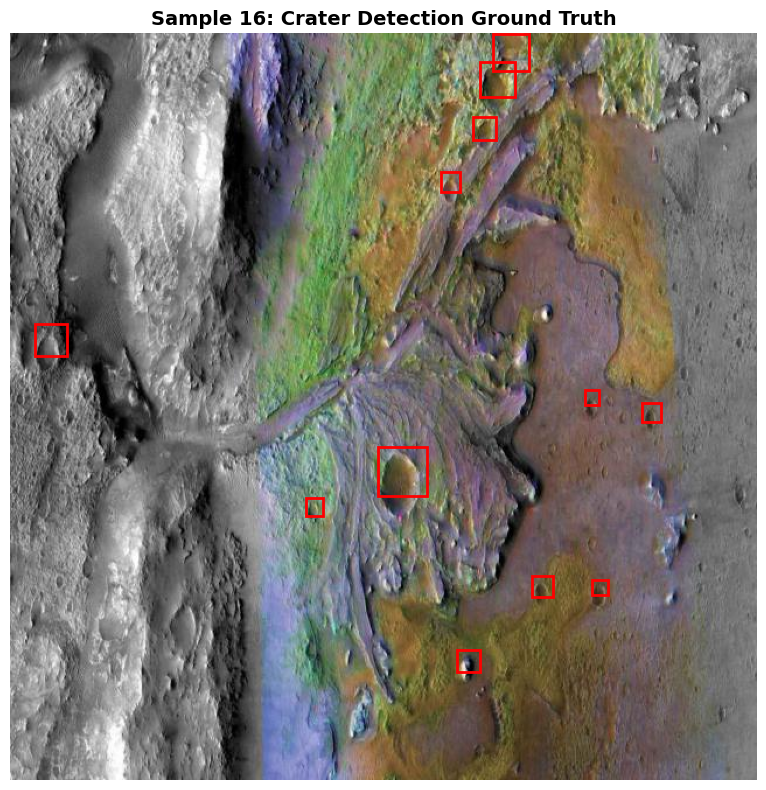

Area containing craters: 2.30%
Validation sample:


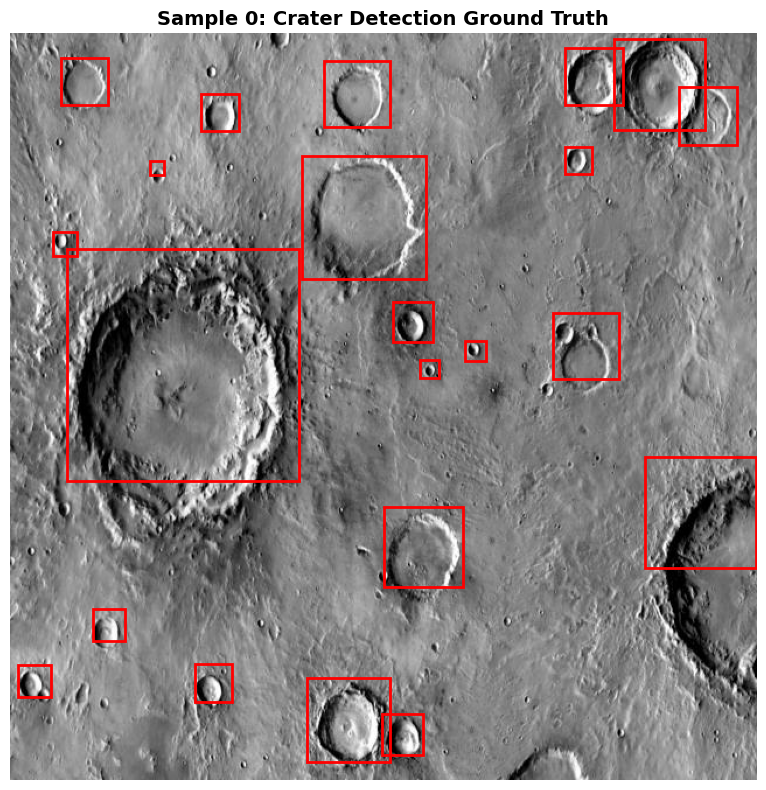

Area containing craters: 26.10%
Test sample


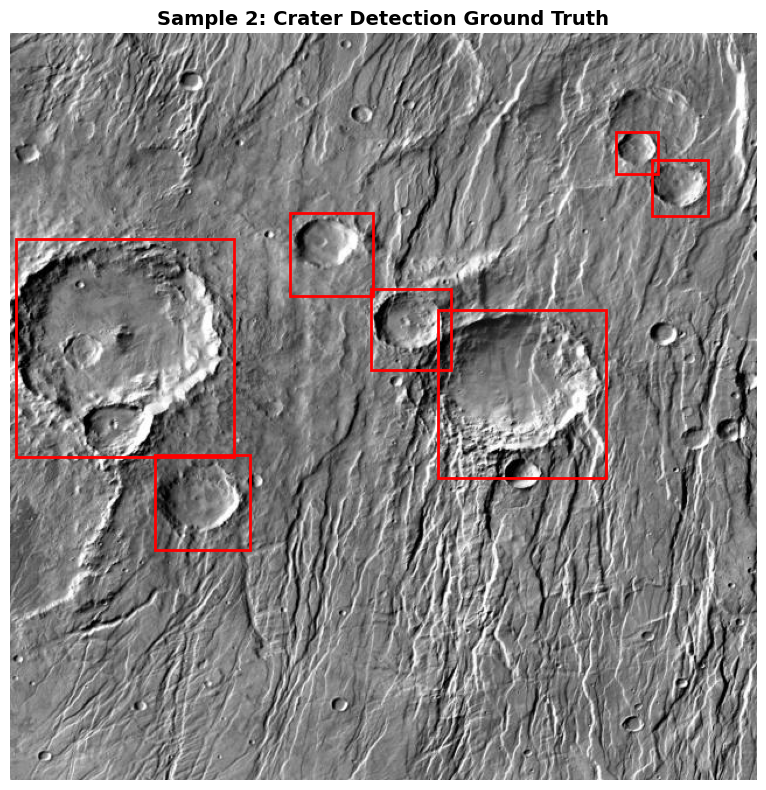

Area containing craters: 13.29%


In [5]:
def visualize_sample(dataset, idx=0, figsize=(12, 8)):
    if len(dataset) == 0:
        print("Empty Dataset")
        return None

    img, target = dataset[idx]
    img_np = img.permute(1, 2, 0).numpy()

    fig, ax = plt.subplots(1, figsize=figsize)
    ax.imshow(img_np)

    boxes = target['boxes']
    labels = target['labels']

    area_covered_by_craters = 0

    for i, (box, label) in enumerate(zip(boxes, labels)):
        x_axis_min, y_axis_min, x_axis_max, y_axis_max = box
        width = x_axis_max - x_axis_min
        height = y_axis_max - y_axis_min

        area_covered_by_craters += 3.1415 * (((width + height)/2) / 2) ** 2

        rect = patches.Rectangle(
            (x_axis_min, y_axis_min), width, x_axis_max - x_axis_min,
            linewidth=2, edgecolor='red', facecolor='none'
        )
        ax.add_patch(rect)

    image_width, image_w = img_np.shape[:2]
    image_area = image_w * image_width
    percentage_area_covered_by_craters = (area_covered_by_craters / image_area) * 100

    ax.set_title(f'Sample {idx}: Crater Detection Ground Truth', fontsize=14, weight='bold')
    ax.axis('off')
    plt.tight_layout()
    plt.show()
    print(f"Area containing craters: {percentage_area_covered_by_craters:.2f}%")

    return area_covered_by_craters, percentage_area_covered_by_craters


if len(train_dataset) > 0:
    print("Training sample:")
    visualize_sample(train_dataset, idx= random.randint(0,len(train_dataset)-1))
    print(18*"=")

if len(val_dataset) > 0:
    print("Validation sample:")
    visualize_sample(val_dataset, idx= random.randint(0,len(val_dataset)-1))
    print(18*"=")

if len(test_dataset) > 0:
    print("Test sample")
    visualize_sample(test_dataset, idx= random.randint(0,len(test_dataset)-1))
    print(18*"=")

In [6]:
def get_detection_model(num_classes):

    model = fasterrcnn_resnet50_fpn(pretrained=True)

    in_features = model.roi_heads.box_predictor.cls_score.in_features
    model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)

    return model

NUM_CLASSES = 2
model = get_detection_model(NUM_CLASSES)
model = model.to(device_used)


print(f"Total parameters: {sum(p.numel() for p in model.parameters()):,}")
print(f"Trainable parameters: {sum(p.numel() for p in model.parameters() if p.requires_grad):,}")


Total parameters: 41,299,161
Trainable parameters: 41,076,761


In [7]:
def collate_fn(batch):

    return tuple(zip(*batch))

BATCH_SIZE = 2
NUM_WORKERS = 0

train_loader = DataLoader(
    train_dataset,
    batch_size=BATCH_SIZE,
    shuffle=True,
    num_workers=NUM_WORKERS,
    collate_fn=collate_fn
)



val_loader = DataLoader(
    val_dataset,
    batch_size=BATCH_SIZE,
    shuffle=False,
    num_workers=NUM_WORKERS,
    collate_fn=collate_fn
)



test_loader = DataLoader(
    test_dataset,
    batch_size=BATCH_SIZE,
    shuffle=False,
    num_workers=NUM_WORKERS,
    collate_fn=collate_fn
)

print(f"Train batches: {len(train_loader)}")
print(f"Validation batches: {len(val_loader)}")
print(f"Test batches: {len(test_loader)}")


Train batches: 46
Validation batches: 13
Test batches: 10


In [8]:
def train_one_epoch(model, optimizer, data_loader, device_used, epoch):

    model.train()
    epoch_loss = 0

    pbar = tqdm(data_loader, desc=f'Epoch {epoch}')
    for images, targets in pbar:
        images = [img.to(device_used) for img in images]
        targets = [{k: v.to(device_used) for k, v in t.items()} for t in targets]

        loss_dict = model(images, targets)
        losses = sum(loss for loss in loss_dict.values())


        optimizer.zero_grad()
        losses.backward()
        optimizer.step()

        epoch_loss += losses.item()
        pbar.set_postfix({'loss': losses.item()})

    return epoch_loss / len(data_loader)

def validate(model, data_loader, device_used):

    model.eval()
    val_loss = 0

    with torch.no_grad():
        for images, targets in tqdm(data_loader, desc='Validating'):
            images = [img.to(device_used) for img in images]
            targets = [{k: v.to(device_used) for k, v in t.items()} for t in targets]
            _ = model(images)

    return val_loss

print("Training functions are ready")

Training functions are ready


## V -  Train the Model



In [9]:
NUM_EPOCHS = 10
LEARNING_RATE = 0.005

params = [p for p in model.parameters() if p.requires_grad]
optimizer = torch.optim.SGD(params, lr=LEARNING_RATE, momentum=0.9, weight_decay=0.0005)
lr_scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=3, gamma=0.1)
train_losses = []

print(f"Starting training for {NUM_EPOCHS} epochs...\n")

for epoch in range(NUM_EPOCHS):
    print(f"Epoch {epoch+1}/{NUM_EPOCHS}")


    avg_loss = train_one_epoch(model, optimizer, train_loader, device_used, epoch+1)
    train_losses.append(avg_loss)

    print(f"\nEpoch {epoch+1} - Average Training Loss: {avg_loss:.4f}")

    lr_scheduler.step()

    if (epoch + 1) % 5 == 0:
        checkpoint_path = f'crater_model_epoch_{epoch+1}.pth'
        torch.save({
            'epoch': epoch + 1,
            'model_state_dict': model.state_dict(),
            'optimizer_state_dict': optimizer.state_dict(),
            'loss': avg_loss,
        }, checkpoint_path)
        print(f"Checkpoint saved: {checkpoint_path}")

print("Finished training...")

Starting training for 10 epochs...

Epoch 1/10


Epoch 1: 100%|██████████| 46/46 [00:18<00:00,  2.44it/s, loss=0.556]



Epoch 1 - Average Training Loss: 0.7414
Epoch 2/10


Epoch 2: 100%|██████████| 46/46 [00:18<00:00,  2.47it/s, loss=0.335]



Epoch 2 - Average Training Loss: 0.4463
Epoch 3/10


Epoch 3: 100%|██████████| 46/46 [00:18<00:00,  2.43it/s, loss=0.958]



Epoch 3 - Average Training Loss: 0.4022
Epoch 4/10


Epoch 4: 100%|██████████| 46/46 [00:18<00:00,  2.44it/s, loss=0.0433]



Epoch 4 - Average Training Loss: 0.3495
Epoch 5/10


Epoch 5: 100%|██████████| 46/46 [00:18<00:00,  2.45it/s, loss=0.362]



Epoch 5 - Average Training Loss: 0.3096
Checkpoint saved: crater_model_epoch_5.pth
Epoch 6/10


Epoch 6: 100%|██████████| 46/46 [00:19<00:00,  2.41it/s, loss=0.261]



Epoch 6 - Average Training Loss: 0.2942
Epoch 7/10


Epoch 7: 100%|██████████| 46/46 [00:18<00:00,  2.44it/s, loss=0.208]



Epoch 7 - Average Training Loss: 0.2849
Epoch 8/10


Epoch 8: 100%|██████████| 46/46 [00:18<00:00,  2.44it/s, loss=0.184]



Epoch 8 - Average Training Loss: 0.2834
Epoch 9/10


Epoch 9: 100%|██████████| 46/46 [00:18<00:00,  2.46it/s, loss=0.198]



Epoch 9 - Average Training Loss: 0.2870
Epoch 10/10


Epoch 10: 100%|██████████| 46/46 [00:18<00:00,  2.45it/s, loss=0.38]



Epoch 10 - Average Training Loss: 0.2823
Checkpoint saved: crater_model_epoch_10.pth
Finished training...


## VI - Plot Training Loss

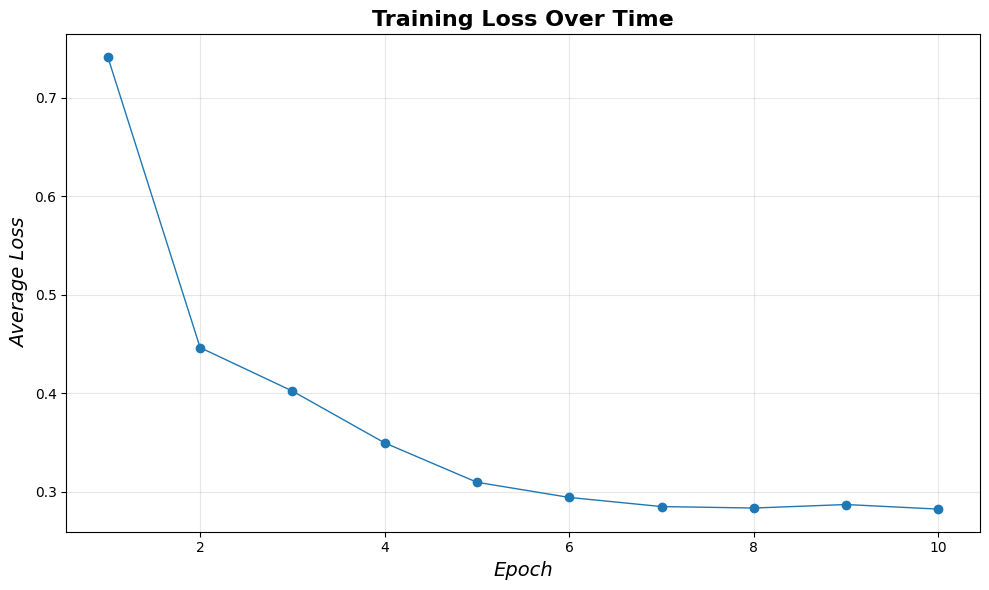

Last training loss: 0.2823


In [10]:
plt.figure(figsize=(10, 6))
plt.plot(range(1, len(train_losses) + 1), train_losses, marker='o', linewidth=1)
plt.xlabel('Epoch', fontsize=14, style='italic')
plt.ylabel('Average Loss', fontsize=14, style='italic')
plt.title('Training Loss Over Time', fontsize=16, weight='bold')
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

print(f"Last training loss: {train_losses[-1]:.4f}")

## Terrain Analysis Module

**_The characteristic of the terrain is analyzed for landing safety:_**

**Slope estimation** Using gradient analysis.  (slope <5°, that meets HLS lander terrain requirements) *source:* ARTEMIS III EVA MISSION CAPABILITY FOR DE GERLACHE-SHACKLETION RIDGE  Z.C. Scoville1, 1Arizona State University, NASA JSC, Houston, TX


In [11]:
class TerrainAnalyzer:

    def __init__(self):
        self.slope_threshold = 5  #(in degrees) limit for lander stability based on the NASA source
        self.roughness_threshold = 0.5

    def estimate_slope(self, image):
        if len(image.shape) == 3:
            gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
        else:
            gray = image

        grad_x = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=5)
        grad_y = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=5)

        gradient_magn = np.sqrt(grad_x**2 + grad_y**2)

        if gradient_magn.max() > 0:
            slope_estimate = (gradient_magn / gradient_magn.max()) * 45
        else:
            slope_estimate = np.zeros_like(gradient_magn)

        return slope_estimate

    def measure_roughness(self, image):

        if len(image.shape) == 3:
            gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
        else:
            gray = image



        kernel_size = 15
        mean = cv2.blur(gray.astype(np.float32), (kernel_size, kernel_size))
        square_mean = cv2.blur((gray.astype(np.float32))**2, (kernel_size, kernel_size))
        variance = square_mean - mean**2
        roughness = np.sqrt(np.abs(variance))

        if roughness.max() > 0:
            roughness = roughness / roughness.max()

        return roughness


    def classify_terrain_type(self, image):

        slope = self.estimate_slope(image)
        roughness = self.measure_roughness(image)



        mean_slope_terrain = slope.mean()
        mean_roughness = roughness.mean()

        if mean_slope_terrain < 5 and mean_roughness < 0.3:
            return "Smooth Plains"
        elif mean_slope_terrain > 15:
            return "Steep Slopes"
        elif mean_roughness > 0.5:
            return "Rocky Terrain"
        else:
            return "Moderate Terrain"





    def assess_landing_suitability(self, image, crater_density):

        score = 0

        if crater_density < 0.1:
            score += 40
        elif crater_density < 0.3:
            score += 20


        slope = self.estimate_slope(image)
        mean_slope_terrain = slope.mean()
        if mean_slope_terrain < 5:
            score += 30
        elif mean_slope_terrain < 10:
            score += 15

        roughness = self.measure_roughness(image)
        mean_roughness = roughness.mean()
        if mean_roughness < 0.3:
            score += 30
        elif mean_roughness < 0.5:
            score += 15

        return score

terrain_analyzer = TerrainAnalyzer()
print("Terrain analyzer ready...")

Terrain analyzer ready...


## VII - Inference Pipeline


In [12]:
def detect_and_analyze_craters(image_path, detection_model, terrain_analyzer,
                                confidence_min=0.5):



    image = cv2.imread(str(image_path))
    if image is None:
        print(f"Error: Could not load image {image_path}")
        return None

    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    img_tensor = transforms.ToTensor()(image_rgb).unsqueeze(0).to(device_used)




    detection_model.eval()
    with torch.no_grad():
        model_predictions = detection_model(img_tensor)[0]

    mask = model_predictions['scores'] > confidence_min
    boxes = model_predictions['boxes'][mask].cpu().numpy()
    scores = model_predictions['scores'][mask].cpu().numpy()
    labels = model_predictions['labels'][mask].cpu().numpy()



    crater_results_data = []

    area_covered_by_craters = 0

    boxes_for_smart_analysis = []

    for i, (box, score, label) in enumerate(zip(boxes, scores, labels)):
        x1, y1, x2, y2 = box.astype(int)

        x1 = max(0, x1)
        y1 = max(0, y1)
        x2 = min(image_rgb.shape[1], x2)
        y2 = min(image_rgb.shape[0], y2)




        if x2 <= x1 or y2 <= y1:
            continue

        crater_patch = image_rgb[y1:y2, x1:x2]
        gray_patch = cv2.cvtColor(crater_patch, cv2.COLOR_RGB2GRAY)

        edges = cv2.Canny(gray_patch, 50, 150)
        edge_density = np.count_nonzero(edges) / edges.size

        width  = x2 - x1
        height = y2 - y1




        area_covered_by_craters += 3.1415 * (((width + height)/2) / 2) ** 2

        crater_results_data.append({
            'box': box,
            'confidence': score,
            'label': label,
            'diameter_pixels': np.sqrt((x2-x1)**2 + (y2-y1)**2)
        })

        boxes_for_smart_analysis.append([x1, y1, x2, y2, score, label])

    terrain_type = terrain_analyzer.classify_terrain_type(image_rgb)
    slope_map = terrain_analyzer.estimate_slope(image_rgb)
    roughness_map = terrain_analyzer.measure_roughness(image_rgb)

    image_area = image_rgb.shape[0] * image_rgb.shape[1]
    crater_density = len(boxes) / (image_area / 1e6)

    percentage_area_covered_by_craters = (area_covered_by_craters / image_area) * 100
    landing_score = terrain_analyzer.assess_landing_suitability(image_rgb, crater_density)
    landing_map_results_data = create_landing_suitability_map(image_rgb, crater_results_data, slope_map, roughness_map)



    area_covered_by_craters_analysis_results_data = calculate_area_covered_by_craters_smart(
        boxes_for_smart_analysis,
        image_rgb.shape,
        confidence_min=confidence_min
    )



    results_data = {
        'image': image_rgb,
        'craters': crater_results_data,
        'terrain_type': terrain_type,
        'slope_map': slope_map,
        'roughness_map': roughness_map,
        'crater_density': crater_density,
        'landing_score': landing_score,
        'percentage_area_covered_by_craters': percentage_area_covered_by_craters,
        'landing_map': landing_map_results_data, #
        'area_covered_by_craters_analysis': area_covered_by_craters_analysis_results_data
    }

    return results_data

print("Pipeline ready")

Pipeline ready


In [13]:
def calculate_area_covered_by_craters_smart(boxes, image_shape, confidence_min=0.5):
    image_width, image_width = image_shape[:2]
    image_area = image_width * image_width




    total_area_covered_by_craters = 0
    full_craters = []
    not_full_craters = []

    edge_tolerance = 5

    for box in boxes:
        x1, y1, x2, y2, score, label = box

        if score < confidence_min:
            continue

        if x2 <= x1 or y2 <= y1:
            continue

        width = x2 - x1
        height = y2 - y1



        crater_radius_x = width / 2
        crater_radius_y = height / 2
        estimated_area_covered_by_craters = np.pi * crater_radius_x * crater_radius_y

        edgestouches_left = x1 <= edge_tolerance
        edgestouches_right = x2 >= (image_width - edge_tolerance)
        edgestouches_top = y1 <= edge_tolerance
        edgestouches_bottom = y2 >= (image_width - edge_tolerance)



        is_partial = edgestouches_left or edgestouches_right or edgestouches_top or edgestouches_bottom



        if is_partial:
            cx = (x1 + x2) / 2
            cy = (y1 + y2) / 2

            full_radius_x_axis = crater_radius_x
            full_radius_y = crater_radius_y




            if edgestouches_left:
                distance_from_edge = cx
                full_radius_x_axis = max(crater_radius_x, x2 - 0)
            if edgestouches_right:
                distance_from_edge = image_width - cx
                full_radius_x_axis = max(crater_radius_x, image_width - x1)
            if edgestouches_top:
                distance_from_edge = cy
                full_radius_y = max(crater_radius_y, y2 - 0)
            if edgestouches_bottom:
                distance_from_edge = image_width - cy
                full_radius_y = max(crater_radius_y, image_width - y1)




            visible_fraction = estimated_area_covered_by_craters / (np.pi * full_radius_x_axis * full_radius_y)
            visible_fraction = np.clip(visible_fraction, 0.3, 1.0)

            estimated_full_area = estimated_area_covered_by_craters / visible_fraction

            not_full_craters.append({
                'box': [x1, y1, x2, y2],
                'confidence': score,
                'visible_area': estimated_area_covered_by_craters,
                'estimated_full_area': estimated_full_area,
                'visible_fraction': visible_fraction,
                'touches_edges': {
                    'left': edgestouches_left,
                    'right': edgestouches_right,
                    'top': edgestouches_top,
                    'bottom': edgestouches_bottom
                }
            })

            total_area_covered_by_craters += estimated_area_covered_by_craters




        else:
            full_craters.append({
                'box': [x1, y1, x2, y2],
                'confidence': score,
                'area': estimated_area_covered_by_craters
            })

            total_area_covered_by_craters += estimated_area_covered_by_craters

    percentage_visible = (total_area_covered_by_craters / image_area) * 100

    total_estimated_full_area = total_area_covered_by_craters
    for partial in not_full_craters:
        total_estimated_full_area += (partial['estimated_full_area'] - partial['visible_area'])

    percentage_adjusted = (total_estimated_full_area / image_area) * 100



    return {
        'total_visible_area': total_area_covered_by_craters,
        'total_estimated_area': total_estimated_full_area,
        'full_craters': full_craters,
        'not_full_craters': not_full_craters,
        'num_full': len(full_craters),
        'num_partial': len(not_full_craters),
        'num_total': len(full_craters) + len(not_full_craters),
        'percentage_visible': percentage_visible,
        'percentage_adjusted': percentage_adjusted,
        'image_area': image_area
    }

print("Smart crater area calculation done")

Smart crater area calculation done


In [25]:
def create_landing_suitability_map(image, craters, slope_map, roughness_map,
                                   full_grid_size=1, visualize=True):
    image_height, image_width = image.shape[:2]




    number_of_rows = image_height // full_grid_size
    number_of_cols = image_width // full_grid_size

    suitability_scores = np.zeros((number_of_rows, number_of_cols))

    #crater_mask = np.zeros((image_height, image_width), dtype=np.uint8)

    #for crater in craters:
        #box = crater['box']
        #x1, y1, x2, y2 = [int(v) for v in box]



        #x1 = max(0, x1)
        #y1 = max(0, y1)
        #x2 = min(image_height, x2)
        #y2 = min(image_width, y2)





        #crater_mask[y1:y2, x1:x2] = 1


    for row in range(number_of_rows):
        for col in range(number_of_cols):
            y_axis_start = row * full_grid_size
            y_axis_end = min(y_axis_start + full_grid_size, image_height)
            x_start = col * full_grid_size
            x_end = min(x_start + full_grid_size, image_width)



            #cell_crater = crater_mask[y_axis_start:y_axis_end, x_start:x_end]
            cell_slope = slope_map[y_axis_start:y_axis_end, x_start:x_end]
            cell_roughness = roughness_map[y_axis_start:y_axis_end, x_start:x_end]



            #crater_coverage = np.mean(cell_crater) * 100
            mean_slope = np.mean(cell_slope)
            max_slope = np.max(cell_slope)
            mean_roughness = np.mean(cell_roughness)
            slope_variance = np.std(cell_slope)

            score = 100

            #if crater_coverage > 0:
                #score -= min(50, crater_coverage * 2)

            if mean_slope > 15:
                score = 0
            elif mean_slope > 10:
                score -= 40
            elif mean_slope > 5:
                score -= 20

            if max_slope > 20:
                score -= 20

            if mean_roughness > 0.5:
                score -= 30
            elif mean_roughness > 0.3:
                score -= 15

            if slope_variance > 3:
                score -= 10

            suitability_scores[row, col] = max(0, score)



    suitability_rgb = np.zeros((number_of_rows, number_of_cols, 3), dtype=np.uint8)



    for row in range(number_of_rows):
        for col in range(number_of_cols):
            score = suitability_scores[row, col]

            if score >= 70:
                suitability_rgb[row, col] = [0, 255, 0]
            elif score >= 40:
                suitability_rgb[row, col] = [255, 165, 0]
            else:
                suitability_rgb[row, col] = [255, 0, 0]

    suitability_map_full = cv2.resize(suitability_rgb, (image_height, image_width),
                                     interpolation=cv2.INTER_NEAREST)



    if visualize:
        overlay = image.copy()
        alpha = 0.4
        overlay = cv2.addWeighted(overlay, 1-alpha, suitability_map_full, alpha, 0)



        return {
            'suitability_scores': suitability_scores,
            'suitability_map': suitability_map_full,
            'overlay': overlay,
            'full_grid_size': full_grid_size,
            'number_of_rows': number_of_rows,
            'number_of_cols': number_of_cols,
            'statistics': {
                'mean_score': np.mean(suitability_scores),
                'max_score': np.max(suitability_scores),
                'min_score': np.min(suitability_scores),
                'good_percentage': (np.sum(suitability_scores >= 70) / suitability_scores.size) * 100,
                'marginal_percentage': (np.sum((suitability_scores >= 40) & (suitability_scores < 70)) / suitability_scores.size) * 100,
                'dangerous_percentage': (np.sum(suitability_scores < 40) / suitability_scores.size) * 100
            }
        }
    else:
        return {
            'suitability_scores': suitability_scores,
            'suitability_map': suitability_map_full
        }

print("Landing suitability map done")

Landing suitability map done


## Visualization

In [26]:
def visualize_complete_analysis(results_data, save_path=None):
    fig = plt.figure(figsize=(20, 14))

    ax1 = plt.subplot(2, 3, 1)
    ax1.imshow(results_data['image'])

    for i, crater in enumerate(results_data['craters']):
        box = crater['box']
        x1, y1, x2, y2 = box

        rect = patches.Rectangle(
            (x1, y1), x2-x1, y2-y1,
            linewidth=2, edgecolor='cyan', facecolor='none'
        )
        ax1.add_patch(rect)



        label_text = f"Crater {i + 1}"
        ax1.text(x1, y1-10, label_text,
                color='cyan', fontsize=8, weight='bold',
                bbox=dict(boxstyle='round', facecolor='black', alpha=0.7))



    ax1.set_title('Crater Detection', fontsize=14, weight='bold')
    ax1.axis('off')

    ax2 = plt.subplot(2, 3, 2)
    ax2.imshow(results_data['landing_map']['overlay'])
    ax2.set_title('LANDING  SUITABILITY MAP', fontsize=14, weight='bold')
    ax2.axis('off')



    from matplotlib.patches import Patch
    legend_elements = [
        Patch(facecolor='green', alpha=0.6, label='Safe Landing (≥70)'),
        Patch(facecolor='orange', alpha=0.6, label='Risky (40-69)'),
        Patch(facecolor='red', alpha=0.6, label='Avoid (<40)')
    ]
    ax2.legend(handles=legend_elements, loc='upper right', fontsize=10)



    ax3 = plt.subplot(2, 3, 3)
    slope_im = ax3.imshow(results_data['slope_map'], cmap='RdYlGn_r', vmin=0, vmax=30)
    ax3.set_title('Slope  Estimate (degrees)', fontsize=12, weight='bold')
    ax3.axis('off')
    plt.colorbar(slope_im, ax=ax3, fraction=0.046, pad=0.04)


    ax4 = plt.subplot(2, 3, 4)
    rough_im = ax4.imshow(results_data['roughness_map'], cmap='plasma')
    ax4.set_title('Surface Roughness ', fontsize=12, weight='bold')
    ax4.axis('off')
    plt.colorbar(rough_im, ax=ax4, fraction=0.046, pad=0.04)





    ax5 = plt.subplot(2, 3, 6)
    ax5.axis('off')

    stats = results_data['landing_map']['statistics']
    crater_information = results_data.get('area_covered_by_craters_analysis', {})






    summary = f"""

LANDING SITE REPORT

I - Terrain Classification: {results_data['terrain_type']}

II - Crater Statistics:
  - Total Craters: {len(results_data['craters'])}
  - Full Craters: {crater_information.get('num_full', 'N/A')}
  - Partial Craters: {crater_information.get('num_partial', 'N/A')}
  - Crater Density: {results_data['crater_density']:.3f}/megapixel
  - Visible Coverage: {crater_information.get('percentage_visible', results_data.get('percentage_area_covered_by_craters', 0)):.2f}%
  - Adjusted Coverage: {crater_information.get('percentage_adjusted', 'N/A'):.2f}%

III - Terrain Characteristics:
  - Mean Slope: {results_data['slope_map'].mean():.2f}°
  - Max Slope: {results_data['slope_map'].max():.2f}°
  - Mean Roughness: {results_data['roughness_map'].mean():.3f}

IV - Landing Zones:
  - GOOD (Green): {stats['good_percentage']:.1f}%
  - MARGINAL (Orange): {stats['marginal_percentage']:.1f}%
  - DANGEROUS (Red): {stats['dangerous_percentage']:.1f}%

OVERALL LANDING SUITABILITY: {results_data['landing_score']}/100


Recommendation:
"""



    if stats['good_percentage'] > 20:
        recommendation = "Multiple safe landing zones available"
        rec_color = 'green'
    elif stats['good_percentage'] > 5 or stats['marginal_percentage'] > 30:
        recommendation = "Limited safe landing options"
        rec_color = 'orange'
    else:
        recommendation = "Terrain too dangerous"
        rec_color = 'red'

    summary += f"  {recommendation}"

    ax5.text(
        0.05, 0.5,
        summary,
        fontsize=12,
        family='sans-serif',
        fontweight='normal',
        va='center',
        ha='left',
        bbox=dict(
            boxstyle='round,pad=0.5',
            facecolor='white',
            edgecolor='black',
            linewidth=0.8,
            alpha=0.9
        )
    )




    plt.tight_layout()

    if save_path:
        plt.savefig(save_path, dpi=150, bbox_inches='tight')
        print(f"Saved to: {save_path}")


    plt.show()

print("Visualization function ready")

Visualization function ready


## Multiple Image Processing
Processing multiple images and generate a summary report.
(Shows models real-time analysis speed)

Testing enhanced detection on: 015_png.rf.7d5b2091b6339c9480a171a59c52c3b9.jpg



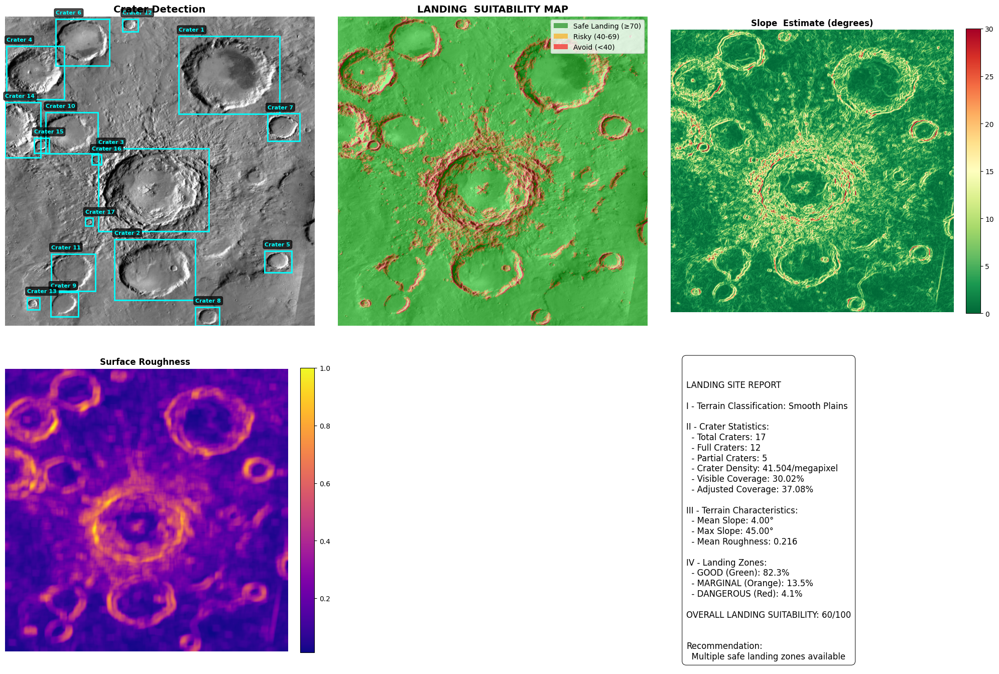

Analysis of the landing site
Good landing zones (green):  82.3% of area
Unsure zones (orange):       13.5% of area
Dangerous zones (red):        4.1% of area

Best suitability score:  100/100


In [32]:
test_image_file_path = glob.glob(os.path.join(TEST_image_path, '*.jpg'))[16]


print(f"Testing enhanced detection on: {os.path.basename(test_image_file_path)}\n")

results_data = detect_and_analyze_craters(
    test_image_file_path,
    model,
    terrain_analyzer,
    confidence_min=0.5
)

visualize_complete_analysis(results_data)


print("Analysis of the landing site")

stats = results_data['landing_map']['statistics']
print(f"Good landing zones (green):{stats['good_percentage']:6.1f}% of area")
print(f"Unsure zones (orange):     {stats['marginal_percentage']:6.1f}% of area")
print(f"Dangerous zones (red):     {stats['dangerous_percentage']:6.1f}% of area")
print(f"\nBest suitability score:  {stats['max_score']:.0f}/100")


Processing 5 images...



  0%|          | 0/5 [00:00<?, ?it/s]

Saved to: /content/Mars_Moon_Crater/test/images/analysis_results_data/analysis_mars_crater--100-_jpg.rf.a2ad5867efb2d73e86d9d980ca40a9fe.jpg


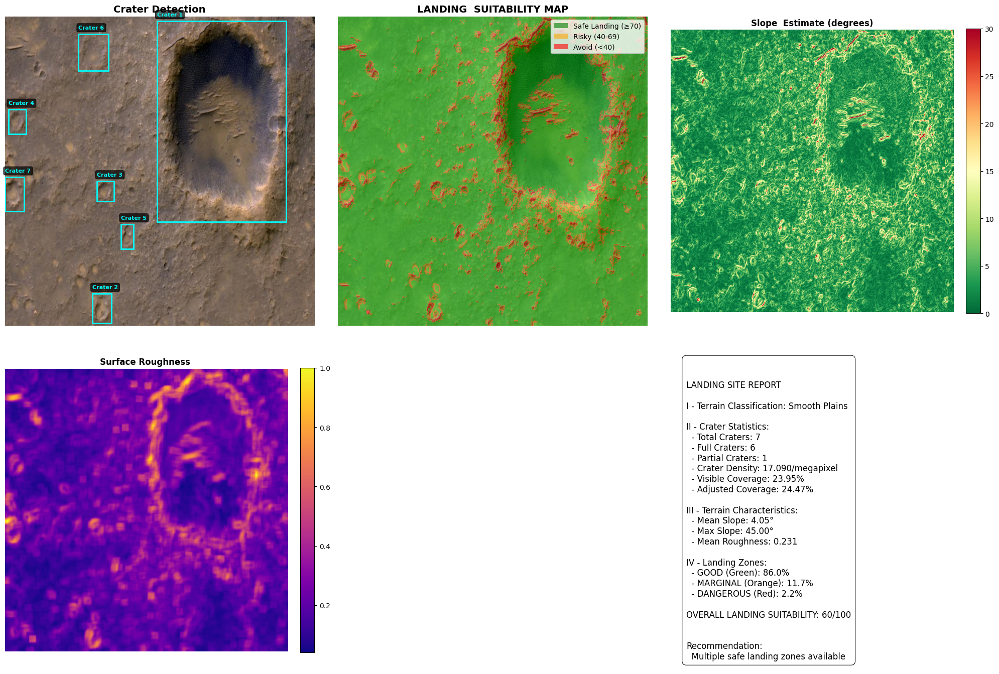

 20%|██        | 1/5 [00:20<01:22, 20.59s/it]

Saved to: /content/Mars_Moon_Crater/test/images/analysis_results_data/analysis_mars_crater--65-_jpg.rf.34ab64f1f6ce5a4b360ea66eae77d4b9.jpg


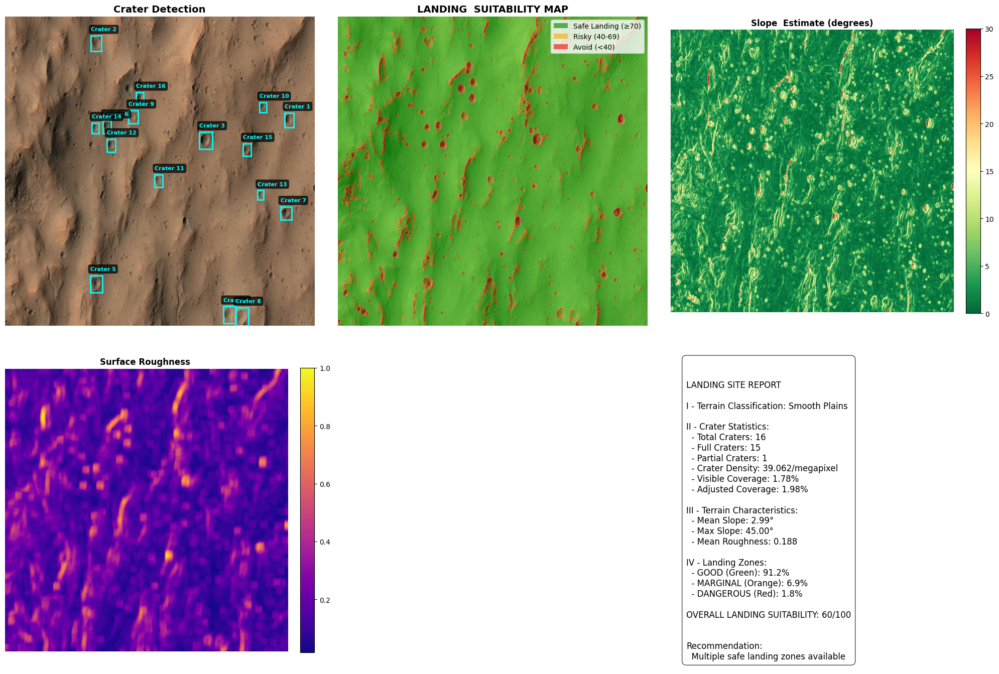

 40%|████      | 2/5 [00:40<01:00, 20.08s/it]

Saved to: /content/Mars_Moon_Crater/test/images/analysis_results_data/analysis_mars_crater--32-_jpg.rf.2f0302a2f32a7b05f5c55e3dac97f1ea.jpg


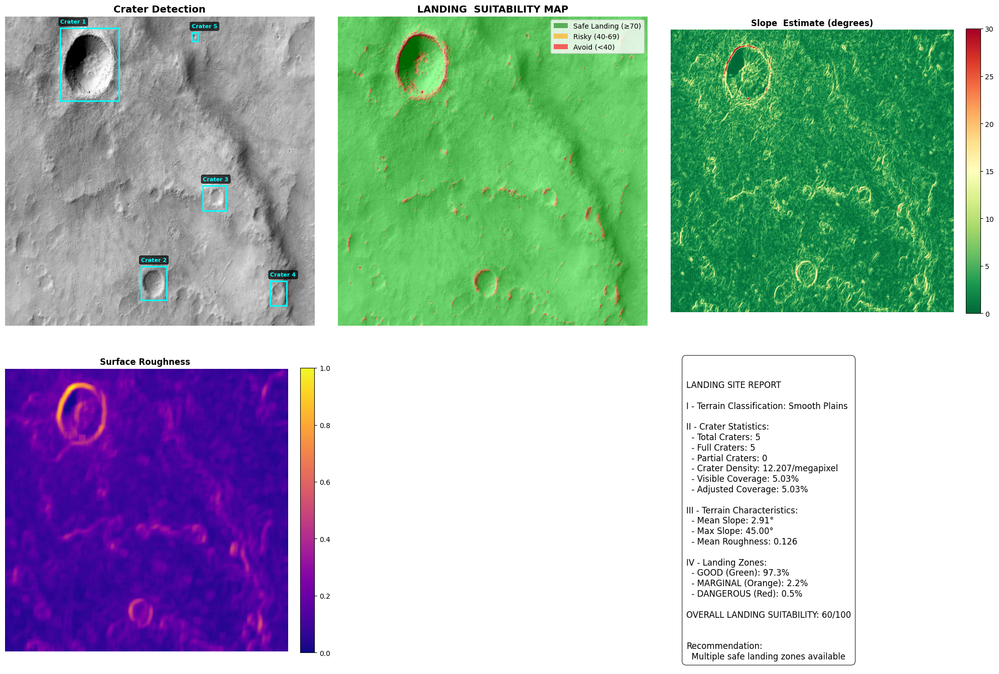

 60%|██████    | 3/5 [01:00<00:40, 20.29s/it]

Saved to: /content/Mars_Moon_Crater/test/images/analysis_results_data/analysis_015_png.rf.7d5b2091b6339c9480a171a59c52c3b9.jpg


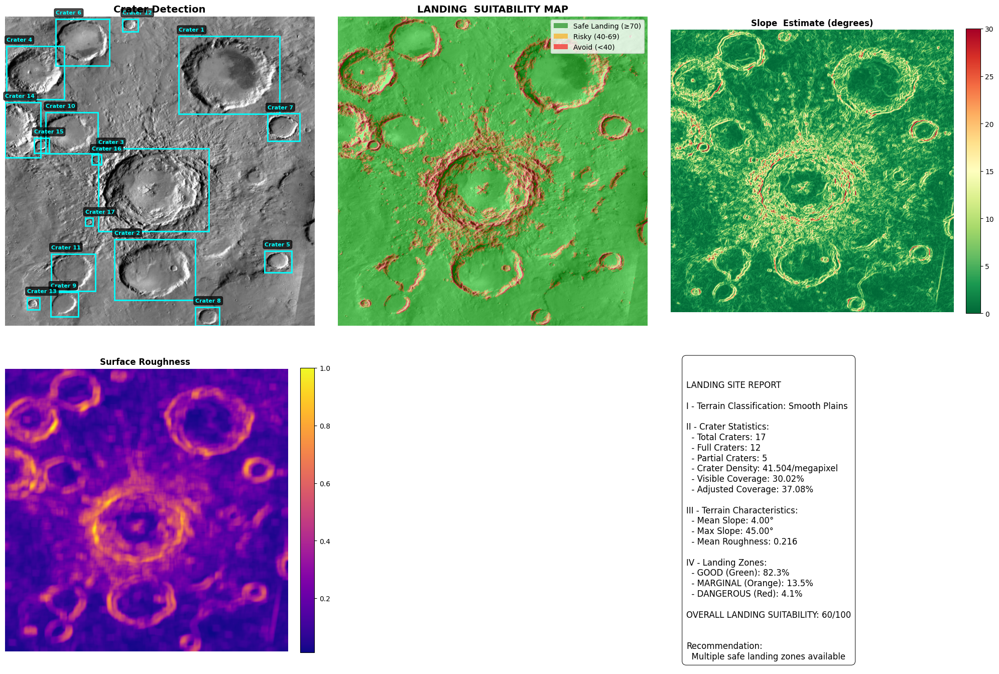

 80%|████████  | 4/5 [01:21<00:20, 20.51s/it]

Saved to: /content/Mars_Moon_Crater/test/images/analysis_results_data/analysis_mars_crater--46-_jpg.rf.369e88a43859f97a595d2091746600f4.jpg


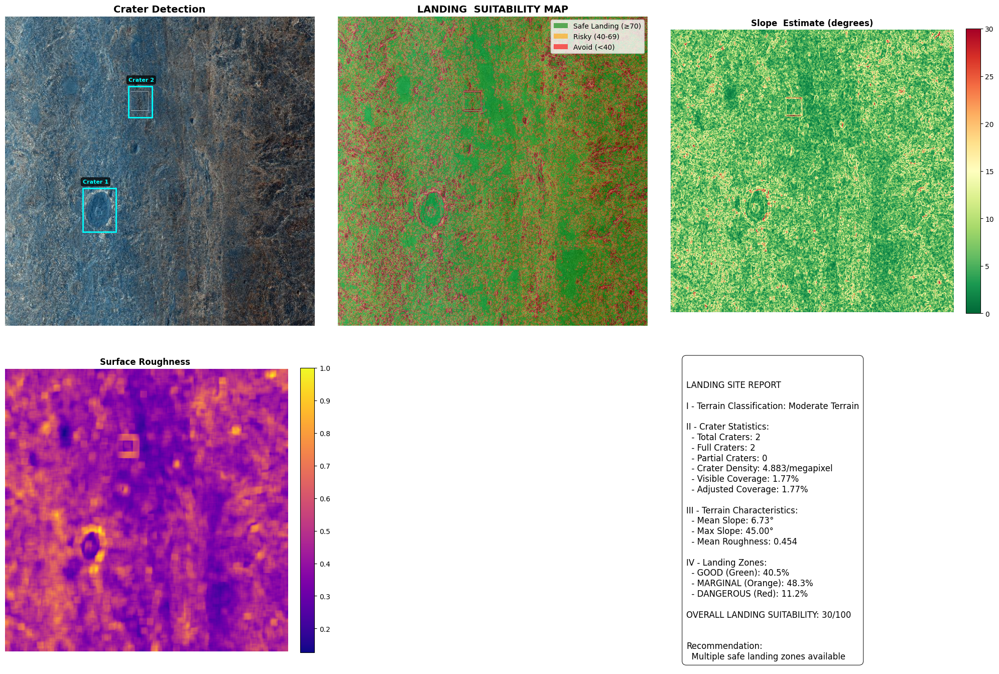

100%|██████████| 5/5 [01:41<00:00, 20.29s/it]

STATISTICS
       num_craters  crater_density  landing_score  mean_slope_terrain  \
count     5.000000        5.000000       5.000000            5.000000   
mean      9.400000       22.949219      54.000000            4.136800   
std       6.730527       16.431952      13.416408            1.548018   
min       2.000000        4.882812      30.000000            2.912660   
25%       5.000000       12.207031      60.000000            2.985774   
50%       7.000000       17.089844      60.000000            4.002685   
75%      16.000000       39.062500      60.000000            4.050580   
max      17.000000       41.503906      60.000000            6.732303   

       mean_roughness  good_landing_percentage  marginal_landing_percentage  \
count        5.000000                 5.000000                     5.000000   
mean         0.243142                79.494727                    16.535010   
std          0.124397                22.517026                    18.327290   
min          0.

In [31]:
def process_all_test_images(test_image_direction, model, terrain_analyzer,
                            output_dir=None, max_images=10):

    test_images = []
    for ext in ['*.jpg', '*.jpeg', '*.png']:
        test_images.extend(glob.glob(os.path.join(test_image_direction, ext)))

    test_images = random.sample(test_images, min(len(test_images), max_images))

    if len(test_images) == 0:
        print("No test images found!")
        return None

    if output_dir is None:
        output_dir = os.path.join(test_image_direction, 'analysis_results_data')
    os.makedirs(output_dir, exist_ok=True)

    all_results_data = []

    print(f"Processing {len(test_images)} images...\n")

    for image_path in tqdm(test_images):
        try:
            results_data = detect_and_analyze_craters(
                image_path, model, terrain_analyzer
            )

            if results_data:
                img_name = os.path.basename(image_path)
                save_path = os.path.join(output_dir, f"analysis_{img_name}")
                visualize_complete_analysis(results_data, save_path=save_path)



                summary = {
                    'image_name': img_name,
                    'num_craters': len(results_data['craters']),
                    'crater_density': results_data['crater_density'],
                    'terrain_type': results_data['terrain_type'],
                    'landing_score': results_data['landing_score'],
                    'mean_slope_terrain': float(results_data['slope_map'].mean()),
                    'mean_roughness': float(results_data['roughness_map'].mean()),
                    'good_landing_percentage': results_data['landing_map']['statistics']['good_percentage'],
                    'marginal_landing_percentage': results_data['landing_map']['statistics']['marginal_percentage'],
                    'dangerous_landing_percentage': results_data['landing_map']['statistics']['dangerous_percentage']
                }
                all_results_data.append(summary)

        except Exception as e:
            print(f"Error processing {image_path}: {e}")

    if len(all_results_data) > 0:
        df = pd.DataFrame(all_results_data)
        csv_path = os.path.join(output_dir, 'landing_site_summary.csv')
        df.to_csv(csv_path, index=False)

        print("STATISTICS")

        print(df.describe())

        return df



    return None

summary_df = process_all_test_images(
    TEST_image_path,
    model,
    terrain_analyzer,
    max_images=5
)

## Saving Model

In [19]:
model_save_path = 'crater_detector_final.pth'

torch.save({
    'model_state_dict': model.state_dict(),
    'architecture': 'Faster R-CNN ResNet-50',
    'num_classes': NUM_CLASSES,
    'training_epochs': NUM_EPOCHS,
    'final_loss': train_losses[-1] if train_losses else None,
}, model_save_path)

print(f"Model saved to: {model_save_path}")
print(f"File size: {os.path.getsize(model_save_path) / (1024*1024):.2f} MB")

Model saved to: crater_detector_final.pth
File size: 158.05 MB


## Conclusions and Next Steps


### Future Enhancements

The 3D analysis is the main enhacement need to calculate the true slope from elevation. Real-time deployement would be very interesting to put in place (with model optimization) and compatibality with spaceraft systems. The incorporation of spectral data within the model could further improve the terrain analysis.


### Resources are:

NASA PDS Imaging Node: https://pds-imaging.jpl.nasa.gov/

